# $$  Purchase \space Analysis:  $$

Problem: You have been hired by an retail store brand to boost their business. You have been given access of their customer purchase history.
You have to analyse their purchase data to note all buiness fact that you can, do a complete EDA of their business, notice any strange pattern, visual those pattern so they can be presented to their investor.
Then you shall also build some machine learning models which can help boost sells.

### Business Context & Objective:
The retail industry is highly competitive, and understanding customer purchasing behavior is crucial for driving growth. The company wants to identify which products sell the most, which products are often bought together, and how customer's shopping habits change over time. This analysis will not only uncover hidden patterns in customer transactions but will also provide actionable insights that can be used to improve product placement, inventory management, and targeted promotions. Furthermore, by building a personalized recommendation system, the business aims to increase basket size, enhance customer experience, and ultimately boost sales and customer loyalty.

### Overall goal:
#### <span> 1) Business goals: <span/>
- Which products generate the most revenue and profit?
- Who are the top customers and how frequently do they shop?
- Which products are often purchased together?
- Are there seasonal or monthly patterns in purchases?
- How can we design promotions and recommendations to increase sales?

and many more usefull insights.

#### <span> 2) End expected outcomes: <span/>
- Figure out sales trends -> which product sales when?, what customer buys something?
- Visual for key patterns -> Top-selling product, customer demographic, seasonality in business.
- Real-time recommendation system to boost customer sales and engagement.


Now, we will look at the available data.

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [11]:
## importing dataset
excel_file = '../Data/online_retail_II.xlsx'

# Try explicitly setting the engine
df1 = pd.read_excel(excel_file, sheet_name="Year 2009-2010")
df2 = pd.read_excel(excel_file, sheet_name="Year 2010-2011")

## sampling dataset
print("Shape: ",df1.shape)
print("Shape: ",df2.shape)
display(df1.head())
display(df2.head())

Shape:  (525461, 8)
Shape:  (541910, 8)


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,13085.0,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,13085.0,United Kingdom


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [74]:
## combine both dataset
data = pd.concat([df1,df2] ,ignore_index=True)
print("Shape of entire dataset: ", data.shape)
print("Ten random samples: ")
data.sample(10)

Shape of entire dataset:  (1067371, 8)
Ten random samples: 


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
297302,518351,22659,LUNCH BOX I LOVE LONDON,2,2010-08-06 14:30:00,1.95,17377.0,United Kingdom
764894,558049,21787,RAIN PONCHO RETROSPOT,2,2011-06-24 14:16:00,0.85,15850.0,United Kingdom
735284,555275,22494,EMERGENCY FIRST AID TIN,1,2011-06-01 17:18:00,2.46,NaN,United Kingdom
1018238,578149,21558,SKULL LUNCH BOX WITH CUTLERY,2,2011-11-23 11:11:00,4.96,NaN,United Kingdom
838566,564436,20754,RETROSPOT RED WASHING UP GLOVES,1,2011-08-25 12:06:00,2.10,17841.0,United Kingdom
310363,519619,21212,PACK OF 72 RETRO SPOT CAKE CASES,1,2010-08-19 09:22:00,1.28,NaN,United Kingdom
671173,548894,85194S,HANGING SPRING FLOWER EGG SMALL,2,2011-04-04 16:01:00,1.63,NaN,United Kingdom
1056702,580908,23301,GARDENERS KNEELING PAD KEEP CALM,4,2011-12-06 13:20:00,1.65,16495.0,United Kingdom
22536,491155,21186,WHITE DOVE HONEYCOMB PAPER GARLAND,1,2009-12-10 09:49:00,3.43,NaN,United Kingdom
470926,533755,72799F,IVORY PILLAR CANDLE GOLD FLOCK,3,2010-11-18 14:25:00,2.95,15571.0,United Kingdom


### PART-A: Look into given dataset

### About Dataset:
This dataset contains detailed transactional data from a retail store, split across two fiscal years:

* Retail Year 2009-2010.csv → 525,461 rows, 8 columns
* Retail Year 2010-2011.csv → 541,910 rows, 8 columns

Each row represents a single product transaction made by a customer.

#### Columns Overview

- Invoice - Unique invoice number for each transaction (can be used to group multiple items from a single order).
- StockCode - Unique product code for the purchased item.
- Description - Text description of the product.
- Quantity - Number of units of the product purchased in that transaction.
- InvoiceDate - Date and time when the transaction was recorded.
- Price - Unit price of the product (in local currency i.e., pound).
- Customer ID - Unique identifier assigned to each customer (some may be missing).
- Country - Country where the customer resides.

This dataset can be used for:
1. Customer purchase behavior analysis
2. Market basket analysis (association rules / recommendations)
3. Sales forecasting
4. Customer segmentation (based on geography, frequency, spending, etc.)


Now, we will analyse our dataset.

In [75]:
## 1) Basic info and structure:
print("Column wise info - ",data.info())
print("List of all columns: ",data.columns)
print("List of index: ",data.index)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1067371 entries, 0 to 1067370
Data columns (total 8 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   Invoice      1067371 non-null  object        
 1   StockCode    1067371 non-null  object        
 2   Description  1062989 non-null  object        
 3   Quantity     1067371 non-null  int64         
 4   InvoiceDate  1067371 non-null  datetime64[ns]
 5   Price        1067371 non-null  float64       
 6   Customer ID  824364 non-null   float64       
 7   Country      1067371 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(4)
memory usage: 65.1+ MB
Column wise info -  None
List of all columns:  Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')
List of index:  RangeIndex(start=0, stop=1067371, step=1)


In [76]:
## 2) Datatypes of each columns
print("Datatypes of each columns: ", data.dtypes)

# customer id need to be converted into int
data['Customer ID'] = data['Customer ID'].astype('Int64')
# Invoice need to be converted into datatime
data['InvoiceDate'] = pd.to_datetime(data['InvoiceDate'])
data['Purchase Date'] = data['InvoiceDate'].dt.date
data['Purchase Time'] = data['InvoiceDate'].dt.time

# Clean description
data['Description'] = data['Description'].astype(str).str.strip().str.lower()

Datatypes of each columns:  Invoice                object
StockCode              object
Description            object
Quantity                int64
InvoiceDate    datetime64[ns]
Price                 float64
Customer ID           float64
Country                object
dtype: object


> Pandas duplicates function was not working properly. So we use custom built function.

In [77]:
import unicodedata, re

def clean_text(s):
    if pd.isna(s):
        return ''
    s = str(s)
    # normalize unicode (NFKC helps)
    s = unicodedata.normalize('NFKC', s)
    # replace common non-breaking spaces
    s = s.replace('\u00A0', ' ')
    # remove ZERO WIDTH and BOM chars
    s = re.sub(r'[\u200B-\u200D\uFEFF]', '', s)
    return s.strip()

# Create a cleaned column for diagnostics
data['Description'] = data['Description'].apply(clean_text)

In [78]:
import re

def custom_find_duplicates(df, subset_cols=None):
    """
    Manually detect duplicate rows based on subset_cols.

    Parameters:
    - df: pandas DataFrame
    - subset_cols: list of columns to check for duplicates.
                   If None, all columns are used.

    Returns:
    - List of indices of duplicate rows
    """
    if subset_cols is None:
        subset_cols = df.columns.tolist()

    seen = {}  # dictionary to store unique row signatures
    duplicate_indices = []

    # Iterate row by row
    for idx, row in df.iterrows():
        # Create a tuple of normalized values for subset columns
        row_signature = tuple(row[col] for col in subset_cols)
        # print(row_signature)

        if row_signature in seen:
            # Already seen → mark as duplicate
            duplicate_indices.append(idx)
        else:
            # First occurrence → store it
            seen[row_signature] = idx

    return duplicate_indices

In [79]:
# ## 3) Duplicate transactions
# subset_cols = ['Invoice', 'StockCode', 'Description', 'Quantity', 'Price', 'Customer ID']
# duplicate_index = custom_find_duplicates(data)

# print("Number of duplicate transactions: ",len(duplicate_index))
# print("Percentage of duplicate transactions: ",len(duplicate_index)/data.shape[0]*100)

In [80]:
## 3 - alt) Duplicate transactions
subset_cols = ['Invoice', 'StockCode', 'Description', 'Quantity', 'Price', 'Customer ID']
duplicate_index = data.index[data.duplicated(subset=subset_cols, keep='first')].tolist()

print("Number of duplicate transactions: ",len(duplicate_index))
print("Percentage of duplicate transactions: ",(len(duplicate_index)/data.shape[0])*100)

Number of duplicate transactions:  34337
Percentage of duplicate transactions:  3.216969544797451


In [81]:
# Drop all duplicate rows
duplicates = data.loc[duplicate_index]
data.drop(duplicate_index, inplace=True)
print(data.shape)

(1033034, 10)


In [82]:
## 4) Missing values
Missing_dataset = data[data.isna().any(axis=1)]
print("Number of missing values: ",Missing_dataset.shape[0])
print("Percentage of missing values: ",Missing_dataset.shape[0]/data.shape[0]*100)

Number of missing values:  235151
Percentage of missing values:  22.763142355430702


> Note: Directly checked missing proportions is not accurate -> false leading.
As missing Customer ID are not lack of information or randomly missing. Missing counter id meas that transaction was made by non-registered aka anonymous person.

Therefore, we will look at customer ID seperately.

In [83]:
missing_except_custid = data.drop(columns=['Customer ID'])
missing_except_custid = missing_except_custid[missing_except_custid.isna().any(axis=1)]
print("Number of missing values: ",missing_except_custid.shape[0])
print("Percentage of missing values: ",missing_except_custid.shape[0]/data.shape[0]*100)

Number of missing values:  0
Percentage of missing values:  0.0


This tells us that there is data missing at random in our complete dataset.
This is a good sign as we don't have to care about missing values.

But this might not be the case always. So, we either
1. only record future transactions with complete details
2. apply general imputation method in any model

In [84]:
## 5) Statistical summary
des = data.describe(include='all').T.round(5)

# Add more metrics
des['unique'] = data.nunique().values

## filling missing values in object (string) type columns
for col in des.select_dtypes(include="object").columns:
  des[col] = des[col].fillna('-')

C:\Users\visha\AppData\Local\Temp\ipykernel_27440\2619527426.py:9: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [85]:
## Visualization in plotly
import plotly.graph_objects as go

# Reset index so index (column names of dataset) appears as first column
des_reset = des.reset_index()

fig = go.Figure(data=[go.Table(
    header=dict(
        values=list(des_reset.columns),
        fill_color='lightblue',
        align='center',
        line_color='black',   # border between header cells
        font=dict(size=15, color='black', family="Arial", weight="bold")  # bold + larger
    ),
    cells=dict(
        values=[des_reset[col] for col in des_reset.columns],
        align='center',
        font=dict(size=12, color='black', family="Arial")  # bigger than default
    )
)])

# Outer border styling
fig.update_layout(
    title="Statistical Summary",
    height=360,
    margin=dict(l=10, r=10, t=50, b=10),
    template="plotly_white"
)

fig.show()


### PART-B: Column-Wise data distribution and Analysis

In [86]:
## 6) Invalid Datapoints and description issues
data['Description'] = data['Description'].str.split().str.join('|')  # remove extra spaces
data['Description'] = data['Description'].str.replace(r'\|+', '|', regex=True)  # replace multiple '|' with single '|'
data['Description'].sample(5)

967054      set|of|3|wooden|tree|decorations
159470        cream|cupid|hearts|coat|hanger
962658              joy|wooden|block|letters
435011      set|3|retrospot|tea,coffee,sugar
471127    chocolate|3|wick|morris|box|candle
Name: Description, dtype: object

In [87]:
## checking for invalid quantity and price
mask_qty_has_alpha = data['Quantity'].astype(str).str.contains(r'[A-Za-z]', na=False)
mask_price_has_alpha = data['Price'].astype(str).str.contains(r'[A-Za-z]', na=False)

data.drop(mask_qty_has_alpha[mask_qty_has_alpha].index, inplace=True)
data.drop(mask_price_has_alpha[mask_price_has_alpha].index, inplace=True)

Also, We can notice many transactions with invalid Description. As description is the main identifier, we need to discard such invalid transactions first.

In [88]:
import re

# Create a regex pattern to match specific invalid substrings
invalid_pattern = re.compile(
    '|'.join([
        r'^\?+$',                          # only question marks
        r'^\.+$',                          # only dots
        r'^(?:nan|null|missing|unknown)$', # placeholders
        r'^(?:test|sample|invalid|none)$', # other placeholders
        r'^(?:postage|shipping|delivery|charges|discount|adjustment)$', # non-product rows
        r'^(?:gift card|gift certificate)$', # gift cards
        r'^(?:thrown|away|sales|given|manual|dotcom)$', # dirty items
    ]),
    flags=re.IGNORECASE
)
# Use the regex pattern to filter rows
invalid_indices = data[data['Description'].str.contains(invalid_pattern, na=False)].index.tolist()

print("Number of invalid descriptions: ", len(invalid_indices))
# Display the first 10 rows with invalid descriptions as a sample
if len(invalid_indices) > 0:
  display(data.iloc[invalid_indices[:4]])

Number of invalid descriptions:  8084


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time
89,489439,POST,postage,3,2009-12-01 09:28:00,18.0,12682,France,2009-12-01,09:28:00
126,489444,POST,postage,1,2009-12-01 09:55:00,141.0,12636,USA,2009-12-01,09:55:00
173,489447,POST,postage,1,2009-12-01 10:10:00,130.0,12362,Belgium,2009-12-01,10:10:00
478,489522,22190,local|cafe|mug,1,2009-12-01 11:45:00,2.1,15998,United Kingdom,2009-12-01,11:45:00


In [89]:
pattern = re.compile(
    r'^(?:\?+|\.{1,}|nan|null|missing|unknown|test|sample|invalid|n/a|none|postage|shipping|delivery|charges|discount|adjustment|thrown|away|sales|given)$',
    flags=re.IGNORECASE
)
# Effective after cleaning:
mask_invalid = data['Description'].str.fullmatch(pattern, na=False)
invalid_transactions = data[mask_invalid]
print("Invalid count:", invalid_transactions.shape[0])
print("Invalid transactions: ")
display(invalid_transactions.head())

Invalid count: 6677
Invalid transactions: 


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time
89,489439,POST,postage,3,2009-12-01 09:28:00,18.0,12682,France,2009-12-01,09:28:00
126,489444,POST,postage,1,2009-12-01 09:55:00,141.0,12636,USA,2009-12-01,09:55:00
173,489447,POST,postage,1,2009-12-01 10:10:00,130.0,12362,Belgium,2009-12-01,10:10:00
470,489521,21646,nan,-50,2009-12-01 11:44:00,0.0,<NA>,United Kingdom,2009-12-01,11:44:00
625,489526,POST,postage,6,2009-12-01 11:50:00,18.0,12533,Germany,2009-12-01,11:50:00


In both codes, <br>
⚡ Why counts are equal but rows differ

- Both methods hit the same order of magnitude of bad descriptions, so the counts match.
- But Code-1 includes valid rows that contain substrings (false positives)
- And it misses some rows with hidden characters that Code-2 catches (false negatives).

Code-1 matches many valid rows also which makes code less interpretable.

Now, we need to remove invalid datapoints.

There are also transactions for 0 amount -> Giveaways. We need to remove them

In [90]:
print("data shape before removing invalid transactions: ", data.shape)

## invalid descriptions
data = data.drop(invalid_transactions.index)
## Free useless transactions
useless_trans = data[(data['Price'] == 0) | (data['Quantity'] == 0)]
data = data.drop(useless_trans.index)


print("data shape after removing invalid transactions: ", data.shape)

data shape before removing invalid transactions:  (1033034, 10)
data shape after removing invalid transactions:  (1024768, 10)


In [91]:
## There are also invalid transactions which are identified through stockcode.
data['StockCode'] = data['StockCode'].astype('str')
invalid_code = data.sort_values('StockCode', ascending=False)

## All stockcode starting with character
invalid_code = invalid_code[invalid_code['StockCode'].str.match(r'^[A-Za-z]', na=False)]
print("Number of invalid stockcodes: ", invalid_code.shape[0])

## removing all invalid transactions
data = data.drop(invalid_code.index)

Number of invalid stockcodes:  3642


In [92]:
## 7) Looking into Numerical Data Distribution:
numerical_variable = data.select_dtypes(include=[np.number]).columns
categorical_variable = data.select_dtypes(include=['category', 'object']).columns

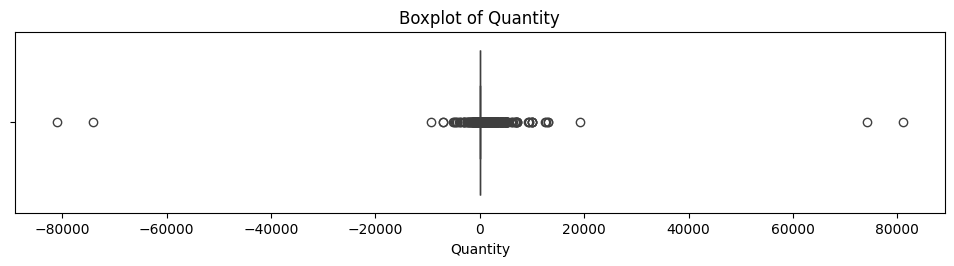

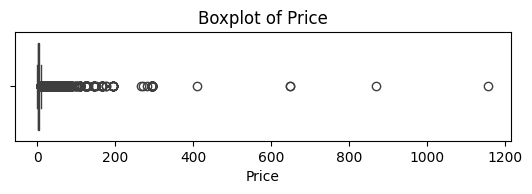

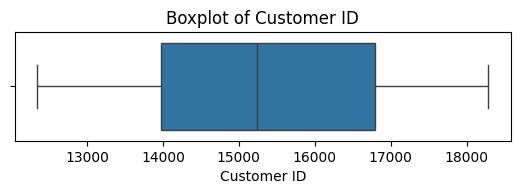

In [93]:
# Boxplots for all numeric variables
L = len(numerical_variable)

plt.figure(figsize=(12, 8))
for ind, col in enumerate(numerical_variable):
    plt.subplot(L,1, ind+1)
    sns.boxplot(x=data[col])
    plt.title(f"Boxplot of {col}")
    plt.show()

On observations, we find there are transactions with -ve price and quantities which is not possible. Lets us look into it:

In [94]:
print("Transactions with -ve price: ")
display(data[data['Price'] < 0])

debt_transactions =  data[data['Price'] < 0]
data = data.drop(debt_transactions.index)

print("Transactions with -ve quantity: ")
display(data[data['Quantity'] < 0])

Transactions with -ve price: 


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time


Transactions with -ve quantity: 


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time
178,C489449,22087,paper|bunting|white|lace,-12,2009-12-01 10:33:00,2.95,16321,Australia,2009-12-01,10:33:00
179,C489449,85206A,cream|felt|easter|egg|basket,-6,2009-12-01 10:33:00,1.65,16321,Australia,2009-12-01,10:33:00
180,C489449,21895,potting|shed|sow|'n'|grow|set,-4,2009-12-01 10:33:00,4.25,16321,Australia,2009-12-01,10:33:00
181,C489449,21896,potting|shed|twine,-6,2009-12-01 10:33:00,2.10,16321,Australia,2009-12-01,10:33:00
182,C489449,22083,paper|chain|kit|retro|spot,-12,2009-12-01 10:33:00,2.95,16321,Australia,2009-12-01,10:33:00
...,...,...,...,...,...,...,...,...,...,...
1065909,C581490,22178,victorian|glass|hanging|t-light,-12,2011-12-09 09:57:00,1.95,14397,United Kingdom,2011-12-09,09:57:00
1065910,C581490,23144,zinc|t-light|holder|stars|small,-11,2011-12-09 09:57:00,0.83,14397,United Kingdom,2011-12-09,09:57:00
1067176,C581568,21258,victorian|sewing|box|large,-5,2011-12-09 11:57:00,10.95,15311,United Kingdom,2011-12-09,11:57:00
1067177,C581569,84978,hanging|heart|jar|t-light|holder,-1,2011-12-09 11:58:00,1.25,17315,United Kingdom,2011-12-09,11:58:00


1. -ve prices come from "adjust bad debt". We have omitted them from analysis under invalid description
2. -ve quantities constitute a significant proportion of transactions. So, on asking we found out that negetive quantities means items being returned.
3. On final analysis, we must degrade item proirity for recommendation if they are returned.

In [95]:
import plotly.graph_objects as go

# Filter data for buying and returning items
data['Amount'] = data['Price'] * data['Quantity']
buying_data = data[data['Quantity'] > 0]
returned_data = data[data['Quantity'] < 0]

print("Distribution of buying items: ")
for col in numerical_variable:
    fig = go.Figure()
    fig.add_trace(go.Box(y=buying_data[col], name=col))
    fig.update_layout(
        title=f"Boxplot of {col} (Buying Items)",
        yaxis_title=col,
        height=400,
        width=600
    )
    fig.show()

print("Distribution of returning items: ")
for col in numerical_variable:
    fig = go.Figure()
    fig.add_trace(go.Box(y=returned_data[col], name=col))
    fig.update_layout(
        title=f"Boxplot of {col} (Returning Items)",
        yaxis_title=col,
        height=400,
        width=600
    )
    fig.show()

Distribution of buying items: 


Distribution of returning items: 


Let us look a little into quantity and price distributions.

In [96]:
## 8) Extreme Values for transactions size:
print("Top 10 largest purchasing transactions: ")
display(buying_data.nlargest(10, 'Quantity'))

print("Top 10 largest returning transactions: ")
display(returned_data.nsmallest(10, 'Quantity'))

Top 10 largest purchasing transactions: 


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time,Amount
1065882,581483,23843,"paper|craft|,|little|birdie",80995,2011-12-09 09:15:00,2.08,16446,United Kingdom,2011-12-09,09:15:00,168469.6
587080,541431,23166,medium|ceramic|top|storage|jar,74215,2011-01-18 10:01:00,1.04,12346,United Kingdom,2011-01-18,10:01:00,77183.6
90857,497946,37410,black|and|white|paisley|flower|mug,19152,2010-02-15 11:57:00,0.10,13902,Denmark,2010-02-15,11:57:00,1915.2
127166,501534,21099,set/6|strawberry|paper|cups,12960,2010-03-17 13:09:00,0.10,13902,Denmark,2010-03-17,13:09:00,1296.0
127168,501534,21091,set/6|woodland|paper|plates,12960,2010-03-17 13:09:00,0.10,13902,Denmark,2010-03-17,13:09:00,1296.0
127169,501534,21085,set/6|woodland|paper|cups,12744,2010-03-17 13:09:00,0.10,13902,Denmark,2010-03-17,13:09:00,1274.4
127167,501534,21092,set/6|strawberry|paper|plates,12480,2010-03-17 13:09:00,0.10,13902,Denmark,2010-03-17,13:09:00,1248.0
135027,502269,21984,pack|of|12|pink|paisley|tissues,10000,2010-03-23 15:36:00,0.25,17940,United Kingdom,2010-03-23,15:36:00,2500.0
135028,502269,21982,pack|of|12|suki|tissues,10000,2010-03-23 15:36:00,0.25,17940,United Kingdom,2010-03-23,15:36:00,2500.0
135029,502269,21980,pack|of|12|red|spotty|tissues,10000,2010-03-23 15:36:00,0.25,17940,United Kingdom,2010-03-23,15:36:00,2500.0


Top 10 largest returning transactions: 


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time,Amount
1065883,C581484,23843,"paper|craft|,|little|birdie",-80995,2011-12-09 09:27:00,2.08,16446,United Kingdom,2011-12-09,09:27:00,-168469.60
587085,C541433,23166,medium|ceramic|top|storage|jar,-74215,2011-01-18 10:17:00,1.04,12346,United Kingdom,2011-01-18,10:17:00,-77183.60
507225,C536757,84347,rotating|silver|angels|t-light|hldr,-9360,2010-12-02 14:23:00,0.03,15838,United Kingdom,2010-12-02,14:23:00,-280.80
359669,C524235,21088,set/6|fruit|salad|paper|cups,-7128,2010-09-28 11:02:00,0.08,14277,France,2010-09-28,11:02:00,-570.24
359670,C524235,21096,set/6|fruit|salad|paper|plates,-7008,2010-09-28 11:02:00,0.13,14277,France,2010-09-28,11:02:00,-911.04
359630,C524235,16047,pop|art|pen|case|&|pens,-5184,2010-09-28 11:02:00,0.08,14277,France,2010-09-28,11:02:00,-414.72
359636,C524235,37340,multicolour|spring|flower|mug,-4992,2010-09-28 11:02:00,0.10,14277,France,2010-09-28,11:02:00,-499.20
359653,C524235,85110,black|silver|flower|t-light|holder,-4752,2010-09-28 11:02:00,0.07,14277,France,2010-09-28,11:02:00,-332.64
359658,C524235,16046,teatime|pen|case|&|pens,-4608,2010-09-28 11:02:00,0.08,14277,France,2010-09-28,11:02:00,-368.64
359654,C524235,85160A,white|bird|garden|design|mug,-4320,2010-09-28 11:02:00,0.13,14277,France,2010-09-28,11:02:00,-561.60


There are multiple large transactions which were later returned. So These are accidently purchases which were later returned. We should remove them from our analyse as these dont matter.

In [97]:
## 9) accidently transactions
buying_data = buying_data.copy()
returned_data = returned_data.copy()
buying_data['orig_index_buy'] = buying_data.index
returned_data['orig_index_ret'] = returned_data.index
if returned_data.iloc[0]['Quantity'] < 0:
    returned_data['Quantity'] = -returned_data['Quantity']
keys = ['StockCode', 'Quantity', 'Customer ID', 'Price']

# Merge on relevant keys
keys = ['StockCode', 'Quantity', 'Customer ID', 'Price', 'Country', 'Purchase Date'] # same purchase data, means accidental buy or bad quality
accidently_transactions = pd.merge(
    buying_data,
    returned_data,
    on=keys,
    how='inner',
    suffixes=('_buy', '_ret')
)
# The original indexes of matched transactions
matched_indexes = accidently_transactions[['orig_index_buy', 'orig_index_ret']]
matched_index = matched_indexes.values.tolist()

# Flatten the list of matched indexes into a 1D array
instant_return_ind = []
for L in matched_index:
  for i in L:
    instant_return_ind.append(i)

print("Accidentally transactions index: ", instant_return_ind)
print("Number of accidental transactions:", len(instant_return_ind))

# Select the accidental transactions
instant_returns = data.loc[instant_return_ind]
print("Accidently transactions: ")
display(instant_returns.head(4))

## For now we remove matched index as we need to deal with them seperately
data_with_acc = data.copy()
data = data.drop(instant_return_ind)
print("Remaining transactions in dataset:", len(data))

Accidentally transactions index:  [187, 178, 188, 179, 189, 180, 190, 181, 191, 182, 192, 183, 193, 184, 194, 185, 195, 186, 244, 197, 245, 199, 252, 196, 253, 200, 254, 198, 255, 201, 256, 202, 257, 203, 258, 204, 259, 205, 260, 206, 261, 207, 262, 208, 719, 316, 724, 317, 1262, 1361, 1263, 1360, 1269, 1376, 1277, 1359, 1278, 1358, 1279, 1357, 1280, 1356, 1281, 1355, 1282, 1354, 1283, 1353, 1366, 1376, 1367, 1357, 1368, 1358, 1369, 1359, 1370, 1360, 1371, 1361, 1372, 1353, 1373, 1354, 1374, 1355, 1375, 1356, 1435, 1427, 1455, 1430, 3092, 2984, 3635, 3469, 4740, 3722, 8623, 9325, 8664, 9323, 8665, 9322, 11680, 11881, 11913, 11911, 11914, 11912, 13197, 13295, 13547, 13651, 13652, 13651, 14292, 14311, 21274, 21283, 23932, 24009, 24040, 23774, 24044, 23775, 25302, 25305, 25825, 25782, 26609, 26928, 26610, 26927, 27469, 27569, 28018, 28063, 28036, 28064, 28044, 28065, 29366, 29114, 29367, 29112, 32466, 32405, 36817, 36850, 37982, 38018, 38215, 38345, 38356, 38344, 40397, 40028, 40398, 4002

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Purchase Time,Amount
187,489450,22087,paper|bunting|white|lace,12,2009-12-01 10:36:00,2.95,16321,Australia,2009-12-01,10:36:00,35.4
178,C489449,22087,paper|bunting|white|lace,-12,2009-12-01 10:33:00,2.95,16321,Australia,2009-12-01,10:33:00,-35.4
188,489450,85206A,cream|felt|easter|egg|basket,6,2009-12-01 10:36:00,1.65,16321,Australia,2009-12-01,10:36:00,9.9
179,C489449,85206A,cream|felt|easter|egg|basket,-6,2009-12-01 10:33:00,1.65,16321,Australia,2009-12-01,10:33:00,-9.9


Remaining transactions in dataset: 1017543


In [98]:
## 10) Countrywise distribution:
countrywise_dist = data['Country'].value_counts().sort_values(ascending=False)
print("Top 5 Countries for Business: ")
display(countrywise_dist[:5])

print("bottom 5 Countries for Business: ")
display(countrywise_dist[-5:])

Top 5 Countries for Business: 


Country
United Kingdom    935899
EIRE               17246
Germany            16630
France             13358
Netherlands         5016
Name: count, dtype: int64

bottom 5 Countries for Business: 


Country
West Indies       54
Bermuda           34
Nigeria           31
Czech Republic    28
Saudi Arabia      10
Name: count, dtype: int64

In [99]:
# Average Order Value by Country
aov_by_country = data.groupby('Country')['Amount'].mean()  #.sum() / data['Country'].value_counts()
aov_by_country = aov_by_country.sort_values(ascending=False)
print("\nAverage Order Value by Country:\n", aov_by_country)

country_aov = aov_by_country.reset_index()
country_aov.columns = ['Country', 'Amount']
Graph = px.bar(country_aov, x='Country', y='Amount', title='Average Order Value by Country')
Graph.show()


Average Order Value by Country:
 Country
Netherlands             108.870700
Australia                95.812687
Japan                    85.110857
Denmark                  81.960660
Sweden                   65.081150
Thailand                 40.401842
Singapore                39.633012
Hong Kong                39.239943
Bermuda                  36.857059
EIRE                     34.754965
Lebanon                  33.431228
Lithuania                31.770649
Norway                   30.487048
Israel                   30.166766
Switzerland              29.896416
Greece                   28.359407
Channel Islands          25.591321
Finland                  25.190422
Czech Republic           23.990000
Spain                    23.409208
Bahrain                  22.710714
Austria                  22.628636
Germany                  22.524712
United Arab Emirates     22.363358
Iceland                  22.169054
France                   21.876348
Cyprus                   20.968147
RSA          

- Netherlands has the highest order value.

We can drop countries with very little business and focus on countries with higher business like U.K.

In [100]:
row_counts = data['Country'].value_counts().sort_index()
invoice_counts = buying_data.groupby('Country')['Invoice'].nunique()
total_amount = buying_data.groupby('Country')['Amount'].sum()
avg_amount = buying_data.groupby('Country')['Amount'].mean()

# Build a combined DataFrame
country_summary = pd.DataFrame({
    'RowTransactions': row_counts,                 # all rows (incl. returns if present)
    'InvoiceTransactions': invoice_counts,         # unique invoices (only positive-qty purchases)
    'TotalAmount': total_amount,
    'AvgAmountPerLine': avg_amount
}).fillna(0)
# Add transaction share (by invoice count) and sort by TotalAmount
country_summary['InvoiceShare%'] = (country_summary['InvoiceTransactions'] / country_summary['InvoiceTransactions'].sum()) * 100
country_summary = country_summary.sort_values(by='RowTransactions', ascending=False)

# Display top/bottom
print("Top 5 countries by No. of transactions:")
display(country_summary.head(5))

print("Bottom 5 countries by No. of transactions:")
display(country_summary.tail(5))

Top 5 countries by No. of transactions:


,RowTransactions,InvoiceTransactions,TotalAmount,AvgAmountPerLine,InvoiceShare%
Country,,,,,
United Kingdom,935899,36184,16799816.30,18.192626,91.567972
EIRE,17246,581,623414.16,36.860058,1.470291
Germany,16630,753,383289.00,24.278774,1.905557
France,13358,598,311090.29,23.639080,1.513311
Netherlands,5016,216,549773.41,110.374104,0.546614


Bottom 5 countries by No. of transactions:


,RowTransactions,InvoiceTransactions,TotalAmount,AvgAmountPerLine,InvoiceShare%
Country,,,,,
West Indies,54,1,536.41,9.933519,0.002531
Bermuda,34,1,1253.14,36.857059,0.002531
Nigeria,31,1,112.57,3.881724,0.002531
Czech Republic,28,2,786.74,32.780833,0.005061
Saudi Arabia,10,1,145.92,16.213333,0.002531


In [101]:
country_summary['AvgTransactionCountPerItem'] = country_summary['RowTransactions'] / country_summary['InvoiceTransactions']
lowest_country = country_summary[(country_summary['RowTransactions'] < 100) | (country_summary['InvoiceTransactions'] <= 1) | (country_summary['TotalAmount'] <= 100) ].index.tolist()
biggest_country = country_summary[(country_summary['RowTransactions'] > 1000) | (country_summary['InvoiceTransactions'] >= 100) | (country_summary['TotalAmount'] >= 100000) ].index.tolist()

print("Countries with lowest Business: ")
print(lowest_country)
print("Countries with most Business: ")
print(biggest_country)

Countries with lowest Business: 
['Brazil', 'Thailand', 'Korea', 'European Community', 'Lebanon', 'West Indies', 'Bermuda', 'Nigeria', 'Czech Republic', 'Saudi Arabia']
Countries with most Business: 
['United Kingdom', 'EIRE', 'Germany', 'France', 'Netherlands', 'Spain', 'Switzerland', 'Belgium', 'Portugal', 'Australia', 'Channel Islands', 'Italy', 'Sweden', 'Norway', 'Cyprus']


We can drop out countires with very little business from models for better results. Also data from countries with most business will be enlightened.

In [102]:
lowBusinessCountry = data[data['Country'].isin(lowest_country)]
print("Low business countries data shape: ", lowBusinessCountry.shape)

data = data.drop(lowBusinessCountry.index)
print("Remaining data shape: ", data.shape)

Low business countries data shape:  (505, 11)
Remaining data shape:  (1017038, 11)


We will now look at purchase date and time in data.

In [103]:
## 11) Purchase Date and Time related features and their analysis:
Time = data[['InvoiceDate','Purchase Date', 'Purchase Time']].copy()

## convert Purchase Time to datetime.
## NOTE: this will set a default date (1900-01-01) which is not relevant here
Time['Purchase Time'] = pd.to_datetime(Time['Purchase Time'], format='%H:%M:%S', errors='coerce')

# Break time into part of day for 6 hour intervals
def part_of_day(hour):
    if 0 <= hour < 6:
        return 'Night'
    elif 6 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 18:
        return 'Afternoon'
    else:
        return 'Evening'

# Now you can extract useful features
Time['Hour'] = Time['Purchase Time'].dt.hour
Time['PartOfDay'] = Time['Hour'].apply(part_of_day)
Time['DayOfWeek'] = Time['InvoiceDate'].dt.day_name()
Time['WeekOfYear'] = Time['InvoiceDate'].dt.isocalendar().week.astype('int32')

In [104]:
part_labels = ['Night', 'Morning', 'Afternoon', 'Evening']
days_order = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

Time['PartOfDay'] = pd.Categorical(Time['PartOfDay'], categories=part_labels, ordered=True)
Time['DayOfWeek'] = pd.Categorical(Time['DayOfWeek'], categories=days_order, ordered=True)

# Optional quick check
print(f"Rows: {len(Time)}  |  Missing Purchase Time: {Time['Purchase Time'].isna().sum()}")

Rows: 1017038  |  Missing Purchase Time: 0


Basic visualisation for time based features

In [105]:
Time.head()

,InvoiceDate,Purchase Date,Purchase Time,Hour,PartOfDay,DayOfWeek,WeekOfYear
0,2009-12-01 07:45:00,2009-12-01,1900-01-01 07:45:00,7,Morning,Tuesday,49
1,2009-12-01 07:45:00,2009-12-01,1900-01-01 07:45:00,7,Morning,Tuesday,49
2,2009-12-01 07:45:00,2009-12-01,1900-01-01 07:45:00,7,Morning,Tuesday,49
3,2009-12-01 07:45:00,2009-12-01,1900-01-01 07:45:00,7,Morning,Tuesday,49
4,2009-12-01 07:45:00,2009-12-01,1900-01-01 07:45:00,7,Morning,Tuesday,49


In [106]:
# ->(1) Countplot for Part of Day
parts_counts = Time['PartOfDay'].value_counts().reindex(part_labels).reset_index()

fig1 = px.bar(parts_counts, x='PartOfDay', y='count',
    text='count', title='Purchases by Part of Day',
    category_orders={'PartOfDay': part_labels}
)
fig1.update_traces(textposition='outside')
fig1.update_layout(xaxis_title='Part of Day', yaxis_title='Number of Purchases')
fig1.show()

In [107]:
# ->(2) Number of purchase for each hour of the day
hourly_counts = Time.groupby('Hour').size().reindex(range(24), fill_value=0).reset_index(name='count')

fig2 = px.bar(hourly_counts, x='Hour', y='count',
    text='count', title='Purchases by Hour of Day',
    labels={'Hour': 'Hour of Day', 'Purchases': 'Number of Purchases'},
    category_orders={'Hour': list(range(24))}
)
fig2.update_traces(textposition='outside')
fig2.update_layout(xaxis_title='Hour of Day', yaxis_title='Number of Purchases',
    xaxis = dict(tickmode='linear', dtick=1))
fig2.show()

- Stores close at 9:00 PM and open at 6:00 AM
- Time of day (hours) distribution is almost normal.
- Vast majority of transactions occus at around 12:00 in the afternoon.

-> We can boost bucket size by including new items which are bought frequently as around 12:00 like ice-cream in the summer.

In [108]:
# remove night from part of day as store is closed
Time = Time[Time['PartOfDay'] != 'Night']
Time['PartOfDay'] = Time['PartOfDay'].cat.remove_categories(['Night'])

In [109]:
# ->(3) Day of week distribution's effects on Part of Day
pivot = Time.pivot_table(index='DayOfWeek', columns='PartOfDay', values='Purchase Time',
    aggfunc='count', margins=True, fill_value=0)

fig3 = px.imshow(pivot.values, x=pivot.columns, y=pivot.index,
    labels = {'x': 'Part of Day', 'y': 'Day of Week', 'color': 'Purchases'}, text_auto=True,
    title = 'Heatmap: Purchases by Day of Week and Parts of Day', aspect = 'auto'
)
fig3.update_xaxes(side='top')
fig3.show()

C:\Users\visha\AppData\Local\Temp\ipykernel_27440\2164265420.py:2: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



- There are very little transactions on saturday (400 in 2 years), so it might not be optimal to keep store open on saturday.
- Store closes early in the morning on saturday,sunday as ther are no transaction on weekend's evening.
- Thursday evening are significantly more busy then any other day of the week.

In [110]:
## combining data and time
data_with_Time = data.merge(Time.drop(columns=['InvoiceDate']), left_index=True, right_index=True)
data_with_Time = data_with_Time.drop(columns=['Purchase Date_y', 'Purchase Time_x']) # drop as we have InvoiceDate
data_with_Time =  data_with_Time.rename(columns={'Purchase Date_x': 'Purchase Date', 'Purchase Time_y': 'Purchase Time'})
data_with_Time['Amount'] = data_with_Time['Price'] * data_with_Time['Quantity']
data_with_Time['Purchase Date'] = pd.to_datetime(data_with_Time['Purchase Date'])
data_with_Time['Year'] = data_with_Time['Purchase Date'].dt.year
data_with_Time.head(3)

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Amount,Purchase Time,Hour,PartOfDay,DayOfWeek,WeekOfYear,Year
0,489434,85048,15cm|christmas|glass|ball|20|lights,12,2009-12-01 07:45:00,6.95,13085,United Kingdom,2009-12-01,83.4,1900-01-01 07:45:00,7,Morning,Tuesday,49,2009
1,489434,79323P,pink|cherry|lights,12,2009-12-01 07:45:00,6.75,13085,United Kingdom,2009-12-01,81.0,1900-01-01 07:45:00,7,Morning,Tuesday,49,2009
2,489434,79323W,white|cherry|lights,12,2009-12-01 07:45:00,6.75,13085,United Kingdom,2009-12-01,81.0,1900-01-01 07:45:00,7,Morning,Tuesday,49,2009


In [111]:
Time_lapse = data_with_Time['Purchase Date'].max() - data_with_Time['Purchase Date'].min()
Total_topline = data_with_Time['Amount'].sum()
print("Total time lapse: ", Time_lapse)
print("Total top line revenue: ", Total_topline)
Average_topline_per_day = Total_topline / Time_lapse.days
print("Average top line revenue per day: ", Average_topline_per_day)

Total time lapse:  738 days 00:00:00
Total top line revenue:  18892417.09
Average top line revenue per day:  25599.481151761516


In [112]:
# ->(4) Revenue distribution by day of week and part of day
pivot = data_with_Time.pivot_table(
    index='DayOfWeek',
    columns='PartOfDay',
    values='Amount',
    aggfunc='sum',
    fill_value=0,
    margins=True,         # optional: adds row/column totals
    margins_name='Total'
)

# Plot heatmap
fig4 = px.imshow(
    pivot.values,
    x=pivot.columns,
    y=pivot.index,
    labels={'x': 'Part of Day', 'y': 'Day of Week', 'color': 'Revenue'},
    text_auto=True,
    title='Heatmap: Revenue by Day of Week and Parts of Day',
    aspect='auto'
)
fig4.update_xaxes(side='top')
fig4.show()

C:\Users\visha\AppData\Local\Temp\ipykernel_27440\1498491633.py:2: FutureWarning:

The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior



- Business makes the most top line on Tuesday and Thursday.
- Our Business in the last 738 days have made an average of 25,617.71268 pound in revenue.

In [113]:
# ->(5) Revenue time-trends
avg_amount_everyday = data_with_Time.groupby('Purchase Date')['Amount'].mean().reset_index()
sum_amount_everyday = data_with_Time.groupby('Purchase Date')['Amount'].sum().reset_index()

fig5 = px.line(sum_amount_everyday, x='Purchase Date', y='Amount',
    title='Daily total Revenue Over Time',
    template='plotly_white', labels={'Purchase Date': 'Date', 'Amount': 'Total Revenue'},
)
fig5.update_layout(xaxis_title='Date', yaxis_title='Total Revenue')
fig5.show()

fig6 = px.line(avg_amount_everyday, x='Purchase Date', y='Amount',
    title='Daily Average Revenue Over Time',
    template='plotly_white', labels={'Purchase Date': 'Date', 'Amount': 'Average Revenue'},
)
fig6.update_layout(xaxis_title='Date', yaxis_title='Total Revenue')
fig6.show()


In [114]:
## Decomposition of time series to see trend, seasonality and residuals
from statsmodels.tsa.seasonal import seasonal_decompose
from plotly.subplots import make_subplots

import plotly.graph_objs as go

# Ensure the data is sorted by date
sum_amount_everyday_sorted = sum_amount_everyday.sort_values('Purchase Date').set_index('Purchase Date')

# Perform seasonal decomposition (additive model)
result = seasonal_decompose(sum_amount_everyday_sorted['Amount'], model='additive', period=7, extrapolate_trend='freq')

# Plotly subplots for decomposition

fig = make_subplots(
    rows=4, cols=1,
    shared_xaxes=True,
    subplot_titles=["Observed", "Trend", "Seasonal", "Residual"]
)

fig.add_trace(go.Scatter(x=sum_amount_everyday_sorted.index, y=result.observed, name='Observed'), row=1, col=1)
fig.add_trace(go.Scatter(x=sum_amount_everyday_sorted.index, y=result.trend, name='Trend'), row=2, col=1)
fig.add_trace(go.Scatter(x=sum_amount_everyday_sorted.index, y=result.seasonal, name='Seasonal'), row=3, col=1)
fig.add_trace(go.Scatter(x=sum_amount_everyday_sorted.index, y=result.resid, name='Residual'), row=4, col=1)

fig.update_layout(
    height=900,
    title_text="Decomposition of Daily Average Revenue Over Time",
    showlegend=False
)
fig.update_xaxes(title_text="Date", row=4, col=1)
fig.update_yaxes(title_text="Value")

fig.show()

In [115]:
# ->(6) Top days by average and total revenue:
print("Dates with highest average revenue: ")
top_avg_revenue_days = avg_amount_everyday.nlargest(10, 'Amount')
display(top_avg_revenue_days)

print("Dates with highest Total revenue: ")
top_sum_revenue_days = sum_amount_everyday.nlargest(10, 'Amount')
display(top_sum_revenue_days)

Dates with highest average revenue: 


,Purchase Date,Amount
24,2010-01-07,68.548510
534,2011-09-20,64.373983
448,2011-06-10,59.372271
325,2011-01-11,47.174166
57,2010-02-15,46.465731
561,2011-10-21,45.106945
258,2010-10-14,44.025795
243,2010-09-27,42.353370
25,2010-01-08,40.219387
575,2011-11-07,40.181330


Dates with highest Total revenue: 


,Purchase Date,Amount
581,2011-11-14,110623.68
534,2011-09-20,108277.04
285,2010-11-15,103134.36
243,2010-09-27,93643.30
276,2010-11-04,87508.49
258,2010-10-14,85321.99
279,2010-11-08,82736.26
575,2011-11-07,82452.09
304,2010-12-07,81066.67
599,2011-12-05,79543.99


In [116]:
# ->(7) Aggregate weekly revenue for Weekly trend analysis
weekly_revenue = data_with_Time.groupby(['Year', 'WeekOfYear'])['Amount'].sum().reset_index()

# Create a readable label for x-axis (e.g., '2025-W01')
weekly_revenue['Week Label'] = weekly_revenue['Year'].astype(str) + '-W' + weekly_revenue['WeekOfYear'].astype(str).str.zfill(2)
# Calculate 3-week moving average for smoothing
weekly_revenue['MA_3'] = weekly_revenue['Amount'].rolling(3, min_periods=1).mean()

# Plot
fig7 = px.line(
    weekly_revenue,
    x='Week Label',
    y='Amount',
    title='Weekly Revenue Trend',
    markers=True,
    template='plotly_white',
    hover_data={'Amount': ':.2f', 'MA_3': ':.2f'}
)

# Add moving average line
fig7.add_scatter(
    x=weekly_revenue['Week Label'],
    y=weekly_revenue['MA_3'],
    mode='lines+markers',
    name='3-Week Moving Average',
    line=dict(dash='dash', color='red')
)

# Update layout
fig7.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=weekly_revenue['Week Label'][::4],  # show every 4th week
        tickangle=-45,
        title = 'Week'
    ),
    yaxis_title='Total Revenue',
    title_x=0.5,
    legend_title='Legend',
)

fig7.show()

In [117]:
print("Top 5 weeks with highest revenue: ")
top_weeks = weekly_revenue.nlargest(5, 'Amount')
display(top_weeks)

Top 5 weeks with highest revenue: 


,Year,WeekOfYear,Amount,Week Label,MA_3
100,2011,46,369183.69,2011-W46,335288.863333
48,2010,45,359004.99,2010-W45,278511.690000
99,2011,45,348338.44,2011-W45,289010.310000
49,2010,46,342717.74,2010-W46,325346.903333
92,2011,38,319745.94,2011-W38,242431.830000


- Week 45 and 46 of the year always has more revenue.

$12)$ Now, we will look into Anonymous transactions.

#### Q. What fraction of customers have not been registered? What is there distribution?

In [118]:
missing_id = data_with_Time[data_with_Time['Customer ID'].isna()]
missingrow = data_with_Time[data_with_Time['Customer ID'].isna()].shape[0]
print("\nNumber of missing rows: ",missingrow)
print("Percentage of missing rows: ",missingrow/data_with_Time.shape[0]*100)
data_with_Time[data_with_Time['Customer ID'].isna()].sample(3)


Number of missing rows:  226715
Percentage of missing rows:  22.291694115657428


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country,Purchase Date,Amount,Purchase Time,Hour,PartOfDay,DayOfWeek,WeekOfYear,Year
976528,575177,82582,area|patrolled|metal|sign,1,2011-11-08 18:41:00,4.13,<NA>,United Kingdom,2011-11-08,4.13,1900-01-01 18:41:00,18,Evening,Tuesday,45,2011
421300,529727,22154,angel|decoration|3|buttons,11,2010-10-29 14:12:00,0.85,<NA>,United Kingdom,2010-10-29,9.35,1900-01-01 14:12:00,14,Afternoon,Friday,43,2010
7384,490030,21837,cross|stitch|alphabet|cushion|cover,6,2009-12-03 12:44:00,5.95,<NA>,United Kingdom,2009-12-03,35.70,1900-01-01 12:44:00,12,Afternoon,Thursday,49,2009


there are 230317 transactions(22.53%)  which have no customer ID associated with them. These are customers which have not registered.

In [119]:
missing_ratio = missing_id['Country'].value_counts() / data_with_Time['Country'].value_counts()
print("Number of countries with only registered customer: ",missing_ratio[missing_ratio.isna()].shape[0])
print("List of all countries with only registered customer: ",missing_ratio[missing_ratio.isna()].index.to_list())

Number of countries with only registered customer:  21
List of all countries with only registered customer:  ['Australia', 'Austria', 'Belgium', 'Canada', 'Channel Islands', 'Cyprus', 'Denmark', 'Finland', 'Germany', 'Greece', 'Iceland', 'Italy', 'Japan', 'Lithuania', 'Malta', 'Netherlands', 'Norway', 'Poland', 'Singapore', 'Spain', 'USA']


<Axes: title={'center': 'Proportion of anonymous customer'}, xlabel='Country'>

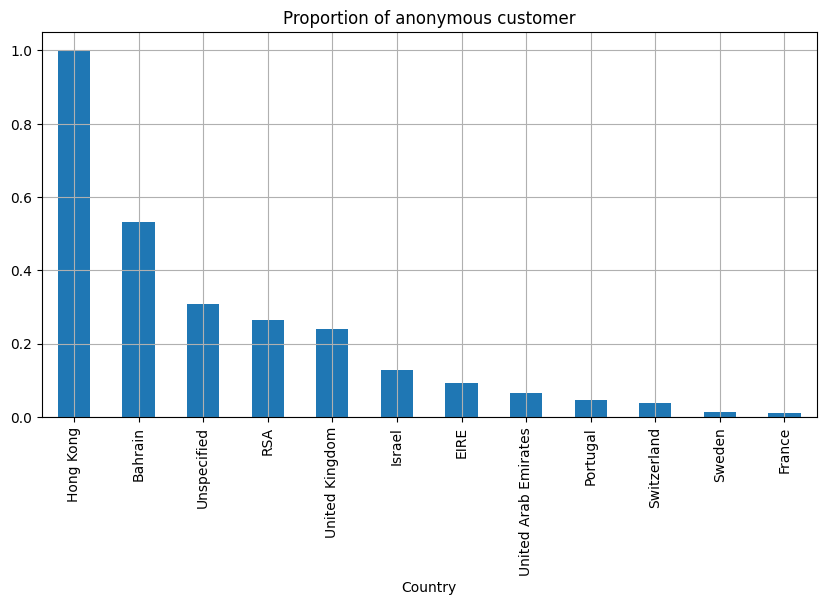

In [120]:
missing_ratio[missing_ratio.notna()].sort_values(ascending=False).plot(kind='bar', title='Proportion of anonymous customer', grid=True,figsize=(10,5))

Top 10 Customers by Number of Transactions: 


<Axes: title={'center': 'Top 10 Customers by Number of Transactions'}, xlabel='Customer ID'>

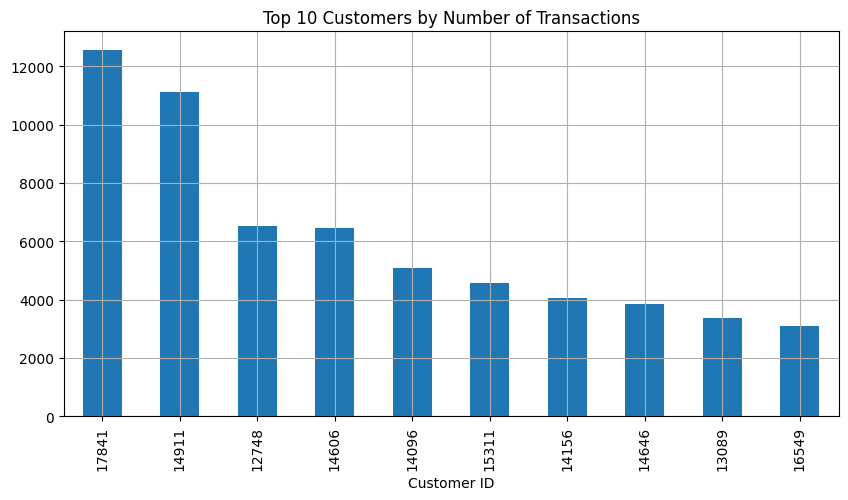

In [121]:
## 13) Top customers:
print("Top 10 Customers by Number of Transactions: ")
data_with_Time['Customer ID'].value_counts().sort_values(ascending=False).head(10).plot(kind='bar', title='Top 10 Customers by Number of Transactions', grid=True, figsize=(10,5))

- We should send gift to these Loyal customer to show some appreciation

For any model, we will deal with anonymous customer seperately but we need to remove missing rows now, or put in a place holder

In [122]:
data_with_Time['Customer ID'] = data_with_Time['Customer ID'].fillna(-1) ## -ve for anonymous
data_with_Time['Customer ID'] = data_with_Time['Customer ID'].astype('int32')
val_cust_id = data_with_Time['Customer ID'].value_counts().sort_values(ascending=False)

In [123]:
print("How many people have only bought once? ", end='\t')
print(val_cust_id[val_cust_id == 1].shape[0])
print("And there customer ID: ", val_cust_id[val_cust_id == 1].index.tolist())

# Find the maximum value after dropping the anonymous customer ID
max_transactions_registered = val_cust_id.drop(index=-1).max()

# Find the customer(s) with this maximum number of transactions
largest_customer = val_cust_id[val_cust_id == max_transactions_registered]

print(f"Biggest registered customer: id -> {largest_customer.index[0]} , total transactions -> {largest_customer.values[0]}")

How many people have only bought once? 	107
And there customer ID:  [15486, 13120, 16144, 14190, 14925, 16220, 14033, 16512, 14576, 17986, 14763, 12896, 15316, 16663, 16738, 18233, 15510, 13383, 15371, 15195, 13105, 14914, 14424, 17291, 15753, 17925, 16995, 15913, 18113, 17645, 13841, 17102, 18068, 15693, 13438, 14090, 13185, 13128, 13366, 15040, 17752, 13942, 13270, 13864, 14366, 17956, 15929, 13535, 13215, 15118, 14351, 16219, 13222, 17077, 16257, 13172, 15284, 12503, 17948, 13391, 14580, 17443, 14900, 15997, 18133, 16443, 15668, 16953, 14705, 16605, 16786, 16165, 13096, 15233, 13788, 15999, 15273, 14266, 14086, 14613, 15893, 17336, 12603, 13906, 16093, 16417, 14095, 14144, 17331, 15657, 15686, 14845, 17347, 15313, 14106, 13099, 16881, 17661, 12814, 17369, 17533, 14120, 17008, 17641, 13205, 18184, 13017]
Biggest registered customer: id -> 17841 , total transactions -> 12566


- We can target new customer with offers, discount to improve churn rate. <br>
  Also, we can ask long time customer who are loyal for any suggestion or imporvements.

In [124]:
## 14) Customer migration
cust_country = data.groupby('Customer ID')['Country'].nunique().sort_values(ascending=False)
migrated = cust_country[cust_country > 1]
print("Number of migrated customer: ", migrated.shape[0])
print("List of migrated customer ID: ", migrated.index.tolist())

Number of migrated customer:  12
List of migrated customer ID:  [12370, 12394, 12431, 12417, 12455, 12449, 12652, 12429, 12422, 12413, 12423, 12457]


In [125]:
## 15) Individual item sales: Sales Volume for each item
item_sales = data_with_Time.groupby(['StockCode','Description'], as_index=True).agg({'Quantity':'sum', 'Price':'mean', 'Customer ID':'nunique', 'Amount':'sum'}).sort_values('Quantity',ascending=False)
item_sales = item_sales.rename(columns={'Quantity':'Total Quantity Sold', 'Price':'Avg Price', 'Customer ID':'Unique Customers count', 'Amount':'Total Sales Amount'})
print("Top 10 items by Sales Volume: ")
display(item_sales.head(10))

Top 10 items by Sales Volume: 


,,Total Quantity Sold,Avg Price,Unique Customers count,Total Sales Amount
StockCode,Description,,,,
84077,world|war|2|gliders|asstd|designs,104435,0.282668,482,24083.93
85123A,white|hanging|heart|t-light|holder,90484,3.068986,1492,248097.15
84879,assorted|colour|bird|ornament,79565,1.858443,1011,128540.28
85099B,jumbo|bag|red|retrospot,75889,2.358150,860,143476.41
17003,brocade|ring|purse,69593,0.672495,215,14543.08
21977,pack|of|60|pink|paisley|cake|cases,55818,0.710892,768,27951.23
84991,60|teatime|fairy|cake|cases,53628,0.663952,820,26825.76
22197,small|popcorn|holder,48198,1.032705,429,42423.71
21212,pack|of|72|retrospot|cake|cases,47695,0.740721,775,27531.08


- We can introduce products which work well with most popular products.

In [126]:
## 16) Averge Order Value (AOV):
inv = data_with_Time.groupby(['Invoice','Customer ID']).agg({'Amount':'sum', 'StockCode':'count'}).reset_index()
inv = inv.rename(columns={'Invoice':'Order Code', 'Amount':'Total Amount', 'StockCode':'No. of items'})

print("Top 5 Orders by Total Amount: ")
display(inv.nlargest(5, 'Total Amount'))
print("Top 5 Orders by unique items: ")
display(inv.nlargest(5, 'No. of items'))
# data_with_Time['AOV'] = data_with_Time['Amount'] / data_with_Time['Invoice'].map()

Top 5 Orders by Total Amount: 


,Order Code,Customer ID,Total Amount,No. of items
36270,574941,-1,52940.94,101
36914,576365,-1,50653.91,99
18174,533027,-1,49844.99,111
17519,531516,-1,45332.97,115
1753,493819,14156,44051.60,94


Top 5 Orders by unique items: 


,Order Code,Customer ID,Total Amount,No. of items
35709,573585,-1,14838.86,1112
39114,581219,-1,7150.07,748
39243,581492,-1,6756.06,730
38887,580729,-1,7848.73,720
29073,558475,-1,7847.43,704


> Largest order are mostly placed by anonymous customer.

In [127]:
## 17) Most returned products:
print("Most returned products: ")
returned_products = data_with_Time[data_with_Time['Quantity'] < 0]
most_returned = returned_products.groupby(['StockCode','Description']).agg({'Quantity':'sum', 'Customer ID':'nunique', 'Amount':'sum'}).sort_values('Quantity', ascending=True)
display(most_returned.head())

Most returned products: 


,,Quantity,Customer ID,Amount
StockCode,Description,,,
84347,rotating|silver|angels|t-light|hldr,-9381,5,-330.45
21088,set/6|fruit|salad|paper|cups,-7140,2,-572.52
21096,set/6|fruit|salad|paper|plates,-7008,1,-911.04
16047,pop|art|pen|case|&|pens,-5184,1,-414.72
85110,black|silver|flower|t-light|holder,-5040,2,-387.36


In [128]:
## 18) Commonly bought together items:
from itertools import combinations
from collections import Counter

## Create product baskets per invoice
baskets = data_with_Time[data_with_Time['Quantity'] > 0].groupby('Invoice')['StockCode'].apply(set)
print(baskets)

# Count product pairs
pair_counts = Counter()
for basket in baskets: # For each basket, get all unique pairs and update counts
    if len(basket) > 1:
        pair_counts.update(Counter(combinations(basket, 2)))

# Dataframe of most common pairs
pairs_df = pd.DataFrame(pair_counts.items(), columns=['Product Pair', 'Count']).sort_values('Count', ascending=False)
pairs_df = pairs_df.rename(columns={'Count': 'Number of Times Bought Together'})
print("Top 10 Product Pairs Frequently Bought Together:\n")
display(pairs_df.head(10))

Invoice
489434    {85048, 21232, 79323W, 79323P, 22041, 22064, 2...
489435                         {22353, 22349, 22195, 22350}
489436    {21754, 22194, 82582, 35004B, 22107, 22111, 84...
489437    {22130, 37370, 10002, 22111, 21364, 84970S, 22...
489438    {20711, 21252, 21100, 85132C, 84032B, 84519A, ...
                                ...                        
581583                                       {85038, 20725}
581584                                       {85038, 20832}
581585    {22113, 22178, 22398, 23356, 84879, 21916, 227...
581586                         {20685, 23275, 21217, 22061}
581587    {22728, 22555, 23255, 22556, 23254, 22613, 227...
Name: StockCode, Length: 39272, dtype: object


KeyboardInterrupt: 

- There are 5 product pair which were bought together more then 1000 times. We should always recommend them in pair.
- Most popular pair of products: {(22386,85099B), (21212, 84991), (85099F, 85099B), (85099C, 85099B), (21231, 21232)}
- These have common product : 85099B -> Jumbo bag red retrospot

In [129]:
# common products in top pairs
data_with_Time.loc[data_with_Time['StockCode'] == '85099B']['Description'].unique()

array(['jumbo|bag|red|white|spotty', 'red|retrospot|jumbo|bag',
       'jumbo|bag|red|retrospot'], dtype=object)

There are also basket with same product order notes twice seperately. These transactions should be combined.

In [130]:
# Find all transactions with the same Invoice and StockCode (i.e., duplicates on these columns)
duplicate_invoice_stockcode = data_with_Time[data_with_Time.duplicated(subset=['Invoice', 'StockCode'], keep=False)]
print(f"Number of transactions with same Invoice and StockCode: {duplicate_invoice_stockcode.shape[0]}")

Number of transactions with same Invoice and StockCode: 22215


In [131]:
data_with_Time.columns

Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country', 'Purchase Date', 'Amount',
       'Purchase Time', 'Hour', 'PartOfDay', 'DayOfWeek', 'WeekOfYear',
       'Year'],
      dtype='object')

In [69]:
print("Shape after combining duplicate (Invoice, StockCode) entries: ", data_with_Time.shape)

# Combine transactions with same (Invoice, StockCode) by summing Quantity and Amount
data_with_Time = data_with_Time.groupby(['Invoice', 'StockCode'], as_index=False).agg({
    'Description': 'first',
    'Quantity': 'sum',
    'InvoiceDate': 'first',
    'Price': 'first',
    'Customer ID': 'first',
    'Country': 'first',
    'Purchase Date': 'first',
    'Purchase Time': 'first',
    'Amount': 'sum',
    'Hour': 'first',
    'PartOfDay': 'first',
    'DayOfWeek': 'first',
    'WeekOfYear': 'first',
    'Year': 'first'
})

print("Shape after combining duplicate (Invoice, StockCode) entries: ", data_with_Time.shape)

Shape after combining duplicate (Invoice, StockCode) entries:  (1017038, 16)
Shape after combining duplicate (Invoice, StockCode) entries:  (1005752, 16)


> Future Data targets: For more insights we need more accurate data for some targeted columns.
1. Each customer's personal info like address, age, gender etc. for Customer Segementation.
2. More info like product category, product brand, quality/rating for better Product Analysis.
3. More long term data for Time based analysis

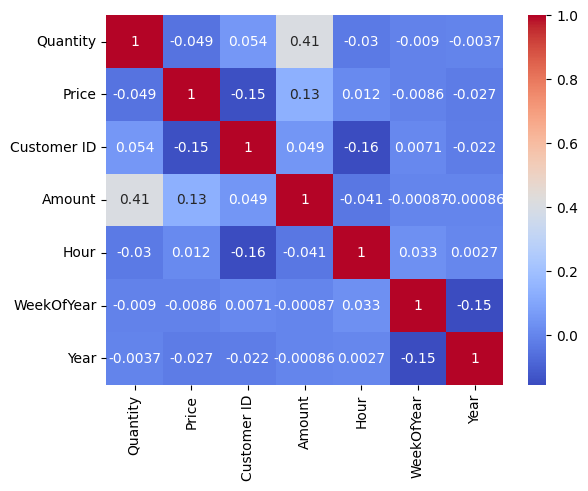

In [70]:
## 18) Correlation analysis:
corr = data_with_Time.corr(numeric_only=True)
sns.heatmap(corr, annot=True, cmap='coolwarm')
plt.show()

- There is no significant Correlation b/w any features. <br>
  So this dataset is not suitable for classification or regression tasks

In [71]:
data_with_Time.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1005752 entries, 0 to 1005751
Data columns (total 16 columns):
 #   Column         Non-Null Count    Dtype         
---  ------         --------------    -----         
 0   Invoice        1005752 non-null  object        
 1   StockCode      1005752 non-null  object        
 2   Description    1005752 non-null  object        
 3   Quantity       1005752 non-null  int64         
 4   InvoiceDate    1005752 non-null  datetime64[ns]
 5   Price          1005752 non-null  float64       
 6   Customer ID    1005752 non-null  int32         
 7   Country        1005752 non-null  object        
 8   Purchase Date  1005752 non-null  datetime64[ns]
 9   Purchase Time  1005752 non-null  datetime64[ns]
 10  Amount         1005752 non-null  float64       
 11  Hour           1005752 non-null  int32         
 12  PartOfDay      1005752 non-null  category      
 13  DayOfWeek      1005752 non-null  category      
 14  WeekOfYear     1005752 non-null  i

In [72]:
# Convert all object columns to strings
for col in data_with_Time.select_dtypes(include='object').columns:
    data_with_Time[col] = data_with_Time[col].astype(str)
data_with_Time['Customer ID'] = data_with_Time['Customer ID'].astype('int32')

## save current cleaned data
# data_with_Time.to_pickle('../Data/data_with_Time.pkl')

In [73]:
# Also save as csv
# data_with_Time.to_csv('../Data/data_with_Time.csv', index=False)
# data_with_Time.to_feather('../Data/data_with_Time.feather')
data_with_Time.to_parquet('../Data/data_with_Time.parquet')